![JohnSnowLabs](https://nlp.johnsnowlabs.com/assets/images/logo.png)


[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/JohnSnowLabs/spark-nlp-workshop/blob/master/tutorials/Certification_Trainings/Finance/10.FinancialVisualDocumentUnderstanding.ipynb)

# Colab Setup

In [ ]:
import json, os
from google.colab import files

if 'spark_jsl.json' not in os.listdir():
  license_keys = files.upload()
  os.rename(list(license_keys.keys())[0], 'spark_ocr.json')

with open('spark_ocr.json') as f:
    license_keys = json.load(f)

# Defining license key-value pairs as local variables
locals().update(license_keys)

In [ ]:
# Installing pyspark and spark-nlp
! pip install --upgrade -q pyspark==3.0.2 spark-nlp==$PUBLIC_VERSION

# Installing Spark NLP Healthcare
!pip -q install --upgrade spark-nlp-jsl==$JSL_VERSION  --extra-index-url https://pypi.johnsnowlabs.com/$SECRET

# Installing Spark OCR
! pip install spark-ocr==$OCR_VERSION --extra-index-url=https://pypi.johnsnowlabs.com/$SPARK_OCR_SECRET --upgrade

<b><h1><font color='darkred'>!!! ATTENTION !!! </font><h1><b>

<b>After running previous cell, <font color='darkred'>RESTART the COLAB RUNTIME </font> and go ahead with the following codes .<b>

In [ ]:
import json, os

with open("spark_ocr.json", 'r') as f:
  license_keys = json.load(f)

# Adding license key-value pairs to environment variables
os.environ.update(license_keys)

# Defining license key-value pairs as local variables
locals().update(license_keys)

In [ ]:
import sparkocr
import sys
from pyspark.sql import SparkSession
from sparkocr import start
import os
import base64
from sparkocr.transformers import *
from pyspark.ml import PipelineModel
from pyspark.sql import functions as F
from sparkocr.enums import *
from sparkocr.utils import display_images

from sparknlp.annotator import *
from sparknlp_jsl.annotator import *
from sparknlp.base import *

In [ ]:
spark = sparkocr.start(secret=SPARK_OCR_SECRET, 
                       nlp_version=PUBLIC_VERSION,
                       nlp_secret=SECRET,
                       nlp_internal=JSL_VERSION
                       )
spark

In [ ]:
spark.conf.set("spark.sql.legacy.allowUntypedScalaUDF", True)
print(spark.conf.get("spark.sql.legacy.allowUntypedScalaUDF"))

******************************
# <b><h1><font color='orange'>This notebook consists of four parts :</font><h1><b>

  ### - Spark OCR Visual Document Classification
  ### - Signature Detection 
  ### - Table Recognition
  ### - Receipt Binary Classification
******************************

## Download and Read Sample images

In [ ]:
!wget -q https://raw.githubusercontent.com/JohnSnowLabs/spark-ocr-workshop/master/jupyter/data/signature/image_147.png
!wget -q https://raw.githubusercontent.com/JohnSnowLabs/spark-nlp-workshop/master/tutorials/streamlit_notebooks/ocr/data/visual_document_examples/Document_advertisement2.png
!wget -q https://raw.githubusercontent.com/JohnSnowLabs/spark-nlp-workshop/master/tutorials/streamlit_notebooks/ocr/data/visual_document_examples/Document_%20letter2.png
!wget -q https://raw.githubusercontent.com/JohnSnowLabs/spark-nlp-workshop/master/tutorials/streamlit_notebooks/ocr/data/visual_document_examples/Document_advertisement.png
!wget -q https://raw.githubusercontent.com/JohnSnowLabs/spark-nlp-workshop/master/tutorials/streamlit_notebooks/ocr/data/visual_document_examples/Document_budget2.png
!wget -q https://raw.githubusercontent.com/JohnSnowLabs/spark-nlp-workshop/master/tutorials/streamlit_notebooks/ocr/data/visual_document_examples/Document_email2.png
!wget -q https://raw.githubusercontent.com/JohnSnowLabs/spark-nlp-workshop/master/tutorials/streamlit_notebooks/ocr/data/visual_document_examples/Document_form.png
!wget -q https://raw.githubusercontent.com/JohnSnowLabs/spark-nlp-workshop/master/tutorials/streamlit_notebooks/ocr/data/visual_document_examples/Document_invoice3.png
!wget -q https://raw.githubusercontent.com/JohnSnowLabs/spark-nlp-workshop/master/tutorials/streamlit_notebooks/ocr/data/visual_document_examples/Document_invoice4.png
!wget -q https://raw.githubusercontent.com/JohnSnowLabs/spark-nlp-workshop/master/tutorials/streamlit_notebooks/ocr/data/visual_document_examples/Document_letter.png
!wget -q https://raw.githubusercontent.com/JohnSnowLabs/spark-nlp-workshop/master/tutorials/streamlit_notebooks/ocr/data/visual_document_examples/Document_news%20article.png
!wget -q https://raw.githubusercontent.com/JohnSnowLabs/spark-nlp-workshop/master/tutorials/streamlit_notebooks/ocr/data/visual_document_examples/Document_presentation.png
!wget -q https://raw.githubusercontent.com/JohnSnowLabs/spark-nlp-workshop/master/tutorials/streamlit_notebooks/ocr/data/visual_document_examples/Document_resume.png
!wget -q https://raw.githubusercontent.com/JohnSnowLabs/spark-ocr-workshop/master/jupyter/data/tab_images/cTDaR_t10168.jpg
!wget -q https://raw.githubusercontent.com/JohnSnowLabs/spark-ocr/master/python/sparkocr/resources/ocr/images/check.jpg?token=GHSAT0AAAAAABVMES4Q2ZOJEOUXLTCY7TDCYZDDW3A
!wget -q https://raw.githubusercontent.com/JohnSnowLabs/spark-nlp-workshop/master/tutorials/Certification_Trainings/Finance/data/visual_document_sample_images/financial_table_extraction.png

In [ ]:
sample_images = spark.read.format("binaryFile").load("*.png").cache()
sample_images.show()

+--------------------+-------------------+-------+--------------------+
|                path|   modificationTime| length|             content|
+--------------------+-------------------+-------+--------------------+
|file:/home/jovyan...|2022-09-19 09:35:24|1799448|[FF D8 FF E0 00 1...|
|file:/home/jovyan...|2022-09-19 09:35:27|1364836|[89 50 4E 47 0D 0...|
|file:/home/jovyan...|2022-09-19 09:35:28| 876092|[89 50 4E 47 0D 0...|
|file:/home/jovyan...|2022-09-19 09:35:29| 465896|[FF D8 FF E0 00 1...|
|file:/home/jovyan...|2022-09-19 09:35:26| 463618|[FF D8 FF E0 00 1...|
|file:/home/jovyan...|2022-09-19 09:35:26| 341744|[FF D8 FF E0 00 1...|
|file:/home/jovyan...|2022-09-19 09:35:25| 305933|[FF D8 FF E0 00 1...|
|file:/home/jovyan...|2022-09-19 09:35:25| 235098|[FF D8 FF DB 00 8...|
|file:/home/jovyan...|2022-09-19 09:35:25| 230268|[FF D8 FF E0 00 1...|
|file:/home/jovyan...|2022-09-19 09:35:28| 215445|[89 50 4E 47 0D 0...|
|file:/home/jovyan...|2022-09-19 09:35:28| 147605|[FF D8 FF E0 0

# Display images


    Image #0:
    Origin: file:/home/jovyan/work/shared/gokhan/FIN_LEGAL/6-Vis.Doc.Clf./image_147.png
    Resolution: 0 dpi
    Width: 2549 px
    Height: 3506 px
    Mode: ImageType.TYPE_BYTE_GRAY
    Number of channels: 1


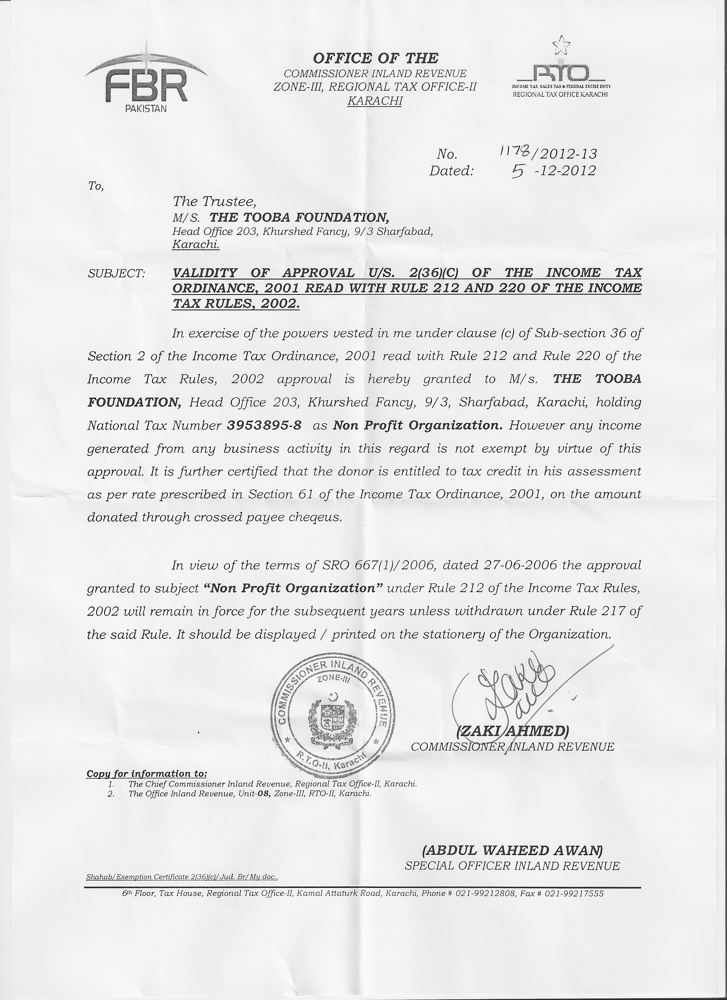


    Image #1:
    Origin: file:/home/jovyan/work/shared/gokhan/FIN_LEGAL/6-Vis.Doc.Clf./Document_invoice3.png
    Resolution: 0 dpi
    Width: 1920 px
    Height: 2889 px
    Mode: ImageType.TYPE_BYTE_GRAY
    Number of channels: 1


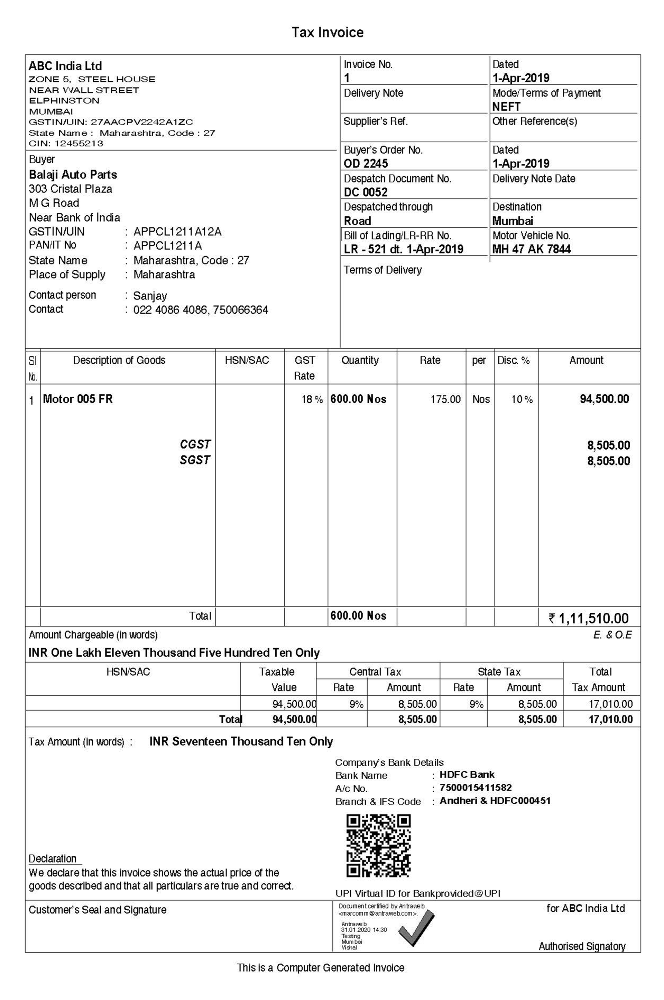


    Image #2:
    Origin: file:/home/jovyan/work/shared/gokhan/FIN_LEGAL/6-Vis.Doc.Clf./Document_presentation.png
    Resolution: 72 dpi
    Width: 1460 px
    Height: 974 px
    Mode: ImageType.TYPE_BYTE_GRAY
    Number of channels: 1


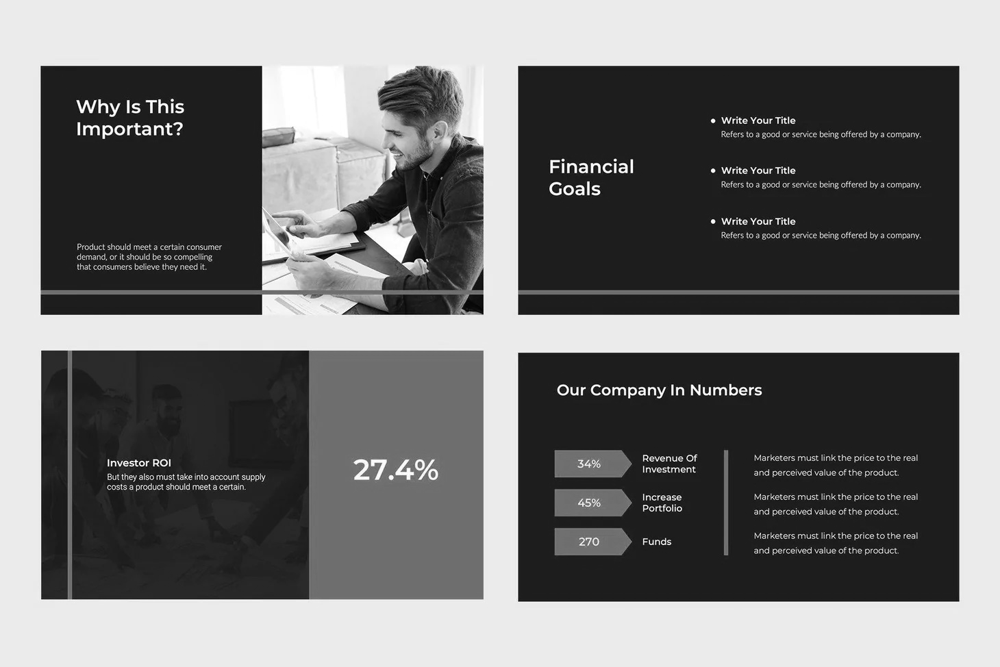


    Image #3:
    Origin: file:/home/jovyan/work/shared/gokhan/FIN_LEGAL/6-Vis.Doc.Clf./Document_resume.png
    Resolution: 300 dpi
    Width: 1978 px
    Height: 2560 px
    Mode: ImageType.TYPE_BYTE_GRAY
    Number of channels: 1


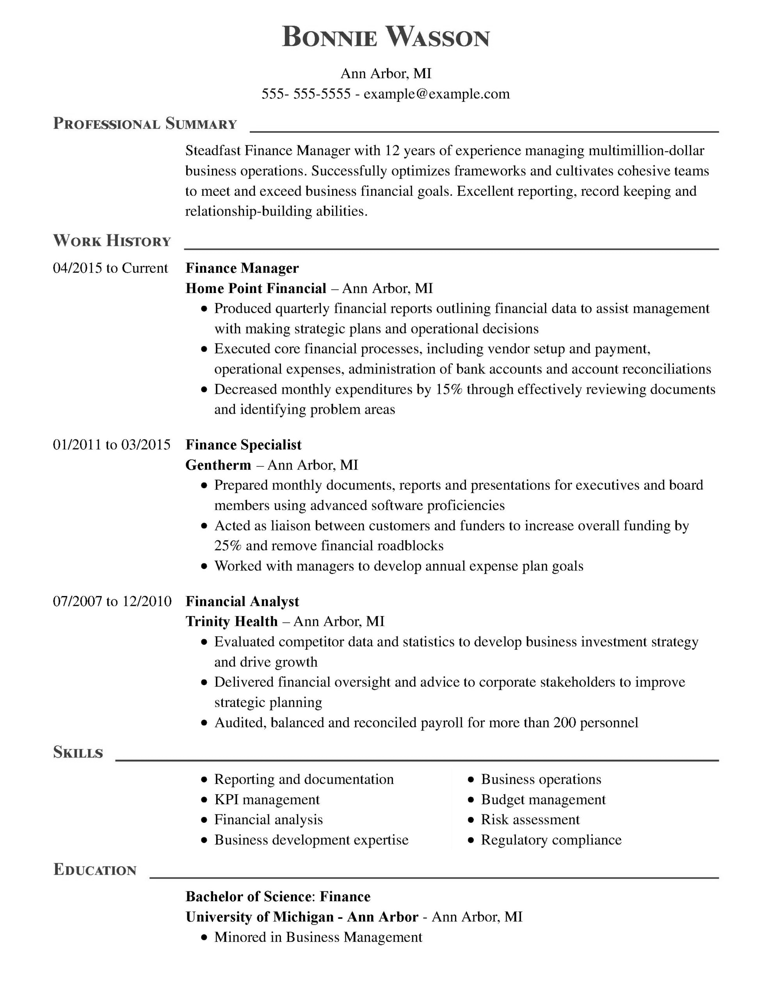


    Image #4:
    Origin: file:/home/jovyan/work/shared/gokhan/FIN_LEGAL/6-Vis.Doc.Clf./Document_form.png
    Resolution: 0 dpi
    Width: 1556 px
    Height: 1760 px
    Mode: ImageType.TYPE_BYTE_GRAY
    Number of channels: 1


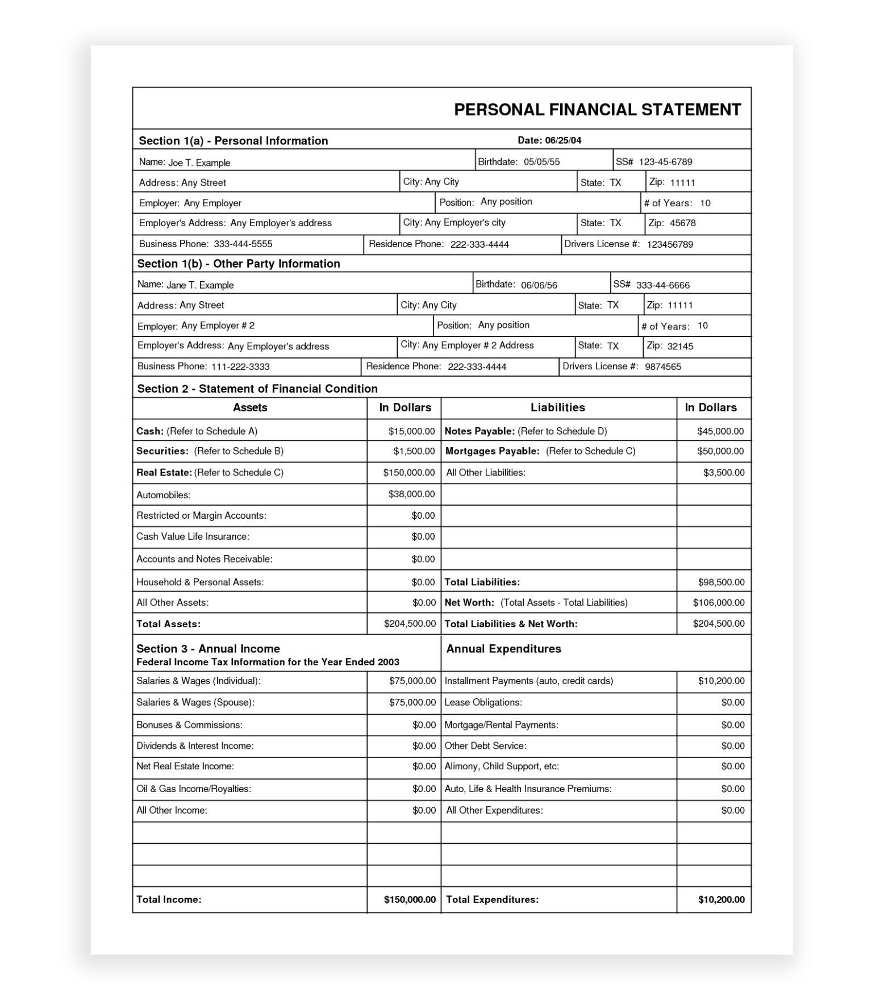

In [ ]:
image_df = BinaryToImage().transform(sample_images)
display_images(image_df)

# Spark OCR Visual Document Classification

🔎With this model, you can classify financial documents using text and layout data with new features offered by Spark OCR.

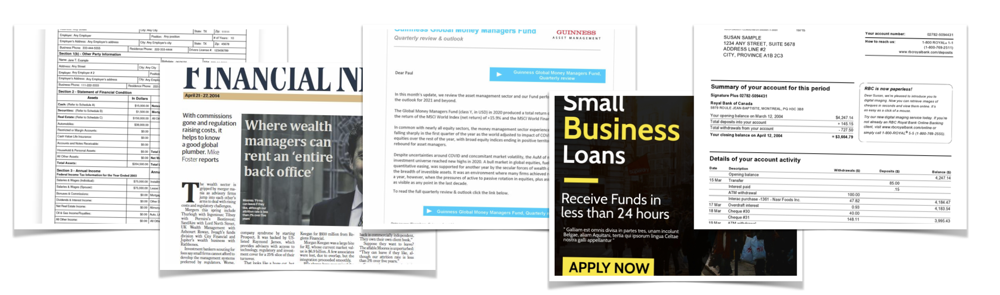

🔎Classes detected by the model:

`letter`
`form`
`email`
`handwritten`
`advertisement`
`scientific report`
`scientific publicatio`
`specification`
`file folder`
`news article`
`budget`
`invoice`
`presentation`
`questionnaire`
`resume`
`memo`

In [ ]:
from sparkocr.utils import get_vocabulary_dict

binary_to_image = BinaryToImage()\
    .setOutputCol("image") \
    .setImageType(ImageType.TYPE_3BYTE_BGR)

doc_class = VisualDocumentClassifierV3() \
    .pretrained("dit_base_finetuned_rvlcdip", "en", "clinical/ocr") \
    .setInputCols(["image"])\
    .setOutputCol("label")

pipeline = PipelineModel(stages=[binary_to_image,
                                 doc_class])

dit_base_finetuned_rvlcdip download started this may take some time.
Approximate size to download 304.8 MB
Download done! Loading the resource.


In [ ]:
results = pipeline.transform(sample_images).cache()

In [ ]:
results

image,path,modificationTime,length,pagenum,label,exception
{file:/home/jovya...,file:/home/jovyan...,2022-09-19 09:35:24,1799448,0,letter,null
{file:/home/jovya...,file:/home/jovyan...,2022-09-19 09:35:27,1364836,0,invoice,null
{file:/home/jovya...,file:/home/jovyan...,2022-09-19 09:35:28,876092,0,presentation,null
{file:/home/jovya...,file:/home/jovyan...,2022-09-19 09:35:29,465896,0,resume,null
{file:/home/jovya...,file:/home/jovyan...,2022-09-19 09:35:26,463618,0,form,null
{file:/home/jovya...,file:/home/jovyan...,2022-09-19 09:35:26,341744,0,budget,null
{file:/home/jovya...,file:/home/jovyan...,2022-09-19 09:35:25,305933,0,advertisement,null
{file:/home/jovya...,file:/home/jovyan...,2022-09-19 09:35:25,235098,0,advertisement,null
{file:/home/jovya...,file:/home/jovyan...,2022-09-19 09:35:25,230268,0,letter,null
{file:/home/jovya...,file:/home/jovyan...,2022-09-19 09:35:28,215445,0,letter,null


In [ ]:
results.select("image", "label")

image,label
{file:/home/jovya...,letter
{file:/home/jovya...,invoice
{file:/home/jovya...,presentation
{file:/home/jovya...,resume
{file:/home/jovya...,form
{file:/home/jovya...,budget
{file:/home/jovya...,advertisement
{file:/home/jovya...,advertisement
{file:/home/jovya...,letter
{file:/home/jovya...,letter


### Our Visual Document Classifier model has predicted the class of each image as seen above,  some of the documents are `financial`.

# Signature Detection 

## Display Image


    Image #0:
    Origin: file:/home/jovyan/work/shared/gokhan/FIN_LEGAL/6-Vis.Doc.Clf./image_147.png
    Resolution: 0 dpi
    Width: 2549 px
    Height: 3506 px
    Mode: ImageType.TYPE_BYTE_GRAY
    Number of channels: 1


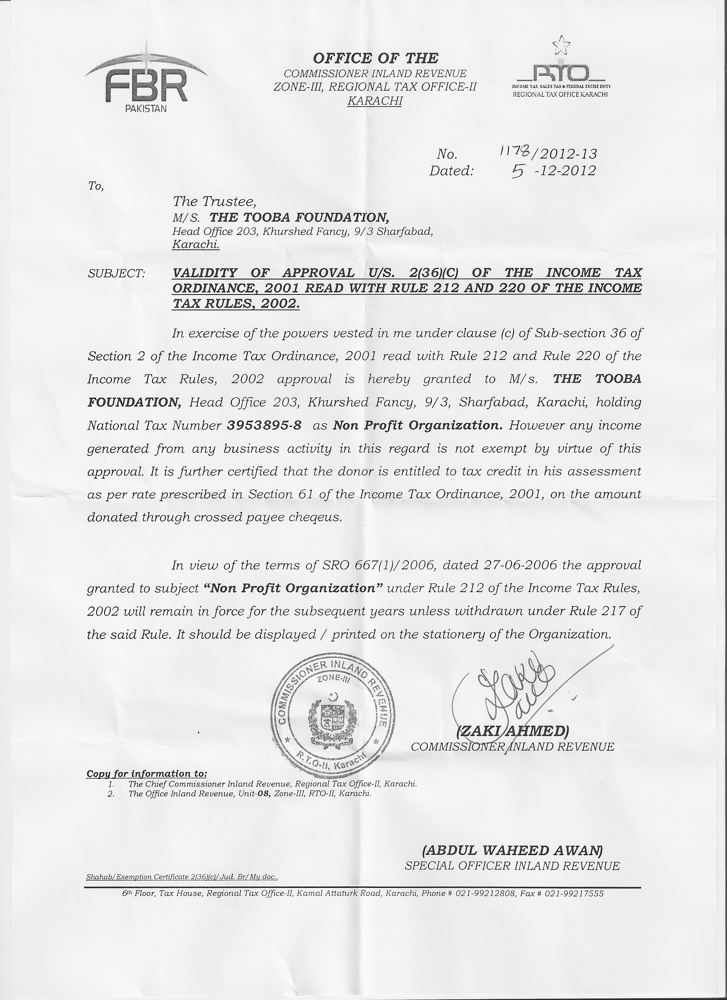

In [ ]:
imagePath = "./image_147.png"

# Read image file as binary file
df = spark.read.format("binaryFile").load(imagePath)

display_images(BinaryToImage().transform(df), "image")

ImageHandwrittenDetector is a DL model for detect handwritten text on the image.

Detector support following labels:

`signature`
`date`
`name`
`title`
`address`
`others`

We will detect `signature` here :

## Define OCR Pipeline for Signature Detection 

In [ ]:
binary_to_image = BinaryToImage()
binary_to_image.setImageType(ImageType.TYPE_3BYTE_BGR)

pretrained_model = ("image_handwritten_detector_gsa0628", "en", "public/ocr/models")
signature_detector = ImageHandwrittenDetector() \
    .pretrained(*pretrained_model) \
    .setInputCol("image") \
    .setOutputCol("signature_regions") \
    .setOutputLabels(["signature"]) \
    .setScoreThreshold(0.4)

draw_regions = ImageDrawRegions() \
   .setInputCol("image") \
   .setInputRegionsCol("signature_regions") \
   .setOutputCol("image_with_regions") \
   .setFontSize(16) \
   .setRectColor(Color.red)

pipeline = PipelineModel(stages=[
    binary_to_image,
    signature_detector,
    draw_regions
])

image_handwritten_detector_gsa0628 download started this may take some time.
Approximate size to download 243.9 MB



    Image #0:
    Origin: file:/home/jovyan/work/shared/gokhan/FIN_LEGAL/6-Vis.Doc.Clf./image_147.png
    Resolution: 0 dpi
    Width: 2549 px
    Height: 3506 px
    Mode: ImageType.TYPE_3BYTE_BGR
    Number of channels: 3


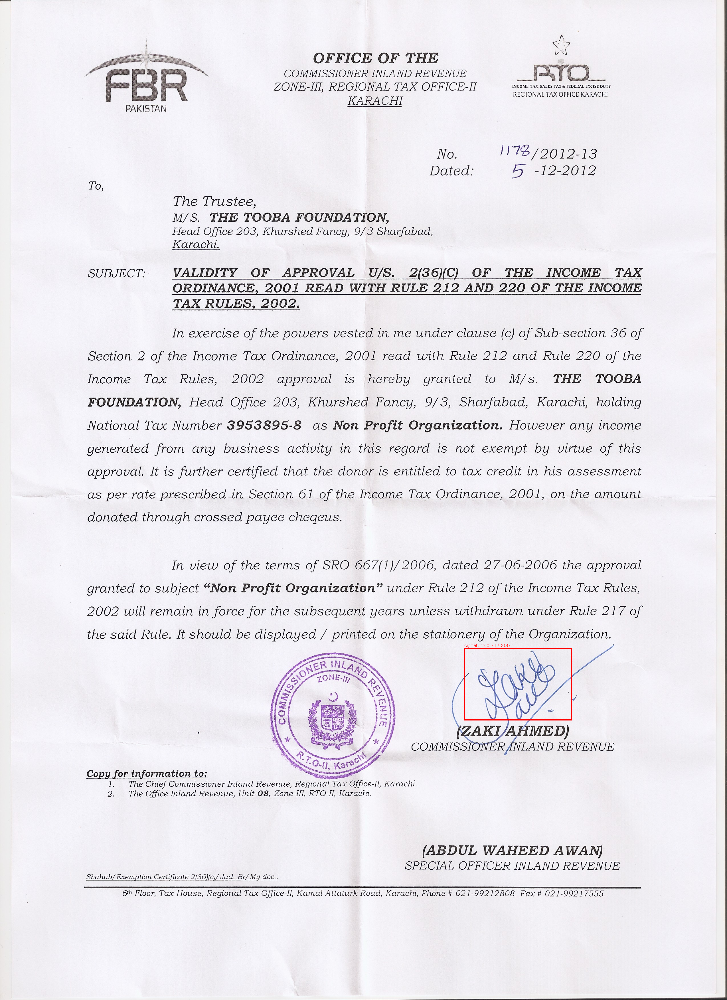

In [ ]:
result =  pipeline.transform(df).cache()
display_images(result, "image_with_regions")

### Display coordinates of regions

In [ ]:
## since pyspark2.3 doesn't have element_at, 'getItem' is involked
path_array = F.split(result['path'], '/')

# from pyspark2.4
results.withColumn("filename", F.element_at(F.split("path", "/"), -1)) \

result.withColumn("coordinate", F.explode_outer(result["signature_regions"])) \
    .withColumn('filename', path_array.getItem(F.size(path_array)- 1)) \
    .withColumn('signed', F.size(result["signature_regions"]) > 0) \
    .select("filename", "signed", "coordinate") \
    .show(truncate=False)

+-------------+------+---------------------------------------------------------------+
|filename     |signed|coordinate                                                     |
+-------------+------+---------------------------------------------------------------+
|image_147.png|true  |{0, 0, 1628.0, 2273.0, 375.0, 251.0, 0.7170037, signature, 0.0}|
+-------------+------+---------------------------------------------------------------+



/home/jovyan/work/shared/venvs/gokhan/lib/python3.8/site-packages/pyspark/sql/column.py:322: FutureWarning: A column as 'key' in getItem is deprecated as of Spark 3.0, and will not be supported in the future release. Use `column[key]` or `column.key` syntax instead.
  warnings.warn(


# Table Recognition


## Dısplay Image


    Image #0:
    Origin: file:/home/jovyan/work/shared/gokhan/FIN_LEGAL/6-Vis.Doc.Clf./financial_table_extraction.png
    Resolution: 0 dpi
    Width: 595 px
    Height: 842 px
    Mode: ImageType.TYPE_BYTE_GRAY
    Number of channels: 1


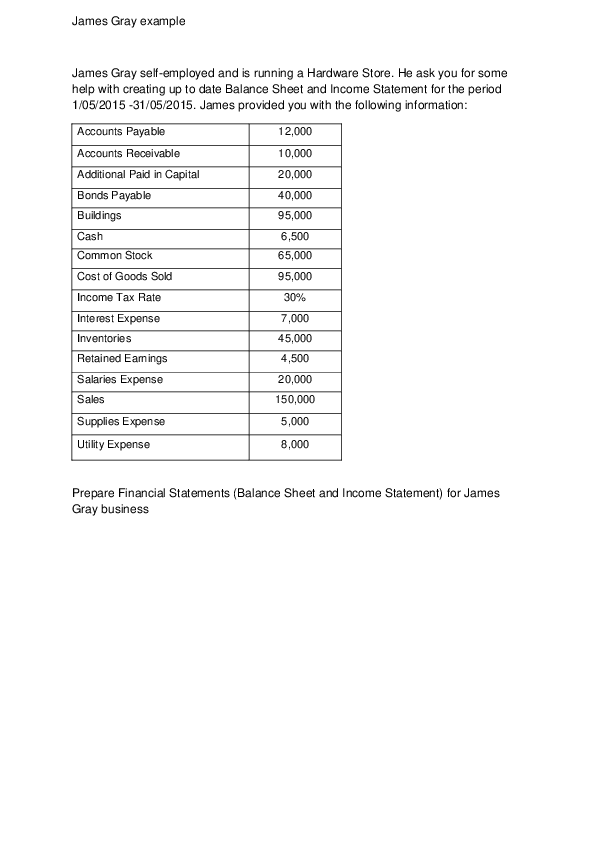

In [ ]:
imagePath = "./financial_table_extraction.png"

# Read image file as binary file
df = spark.read.format("binaryFile").load(imagePath)

display_images(BinaryToImage().transform(df), "image")

🔎 `ImageTableDetector` is a DL model for detecting tables on the image.
`ImageTableCellDetector` detect cells in a table image.
`ImageCellsToTextTable` runs OCR for cells regions on image, return recognized text to outputCol as TableContainer structure.

## Define OCR Pipeline for Table Recognition

In [ ]:
binary_to_image = BinaryToImage()

table_detector = ImageTableDetector.pretrained("general_model_table_detection_v2", "en", "clinical/ocr")
table_detector.setInputCol("image")
table_detector.setOutputCol("region")

splitter = ImageSplitRegions()
splitter.setInputCol("image")
splitter.setInputRegionsCol("region")
splitter.setOutputCol("table_image")
splitter.setDropCols("image")
splitter.setImageType(ImageType.TYPE_BYTE_GRAY)

scaler = ImageScaler()
scaler.setInputCol("table_image")
scaler.setOutputCol("scaled_image")
scaler.setScaleFactor(2)

cell_detector = ImageTableCellDetector()
cell_detector.setInputCol("scaled_image")
cell_detector.setOutputCol("cells")
cell_detector.setKeepInput(True)

table_recognition = ImageCellsToTextTable()
table_recognition.setInputCol("scaled_image")
table_recognition.setCellsCol('cells')
table_recognition.setMargin(2)
table_recognition.setStrip(True)
table_recognition.setOutputCol('table')

pipeline = PipelineModel(stages=[
    binary_to_image,
    table_detector,
    splitter,
    scaler,
    cell_detector,
    table_recognition
])

general_model_table_detection_v2 download started this may take some time.
Approximate size to download 264.7 MB
general_model_table_detection_v2 download started this may take some time.
Approximate size to download 264.7 MB
Download done! Loading the resource.



    Image #0:
    Origin: file:/home/jovyan/work/shared/gokhan/FIN_LEGAL/6-Vis.Doc.Clf./financial_table_extraction.png
    Resolution: 0 dpi
    Width: 273 px
    Height: 340 px
    Mode: ImageType.TYPE_BYTE_GRAY
    Number of channels: 1


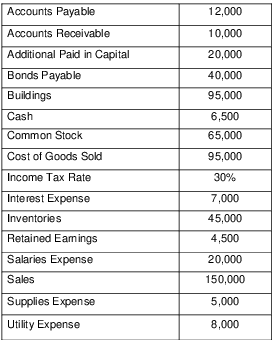

In [ ]:
results = pipeline.transform(df).cache()
display_images(results, "table_image")

## Display recognized tables

In [ ]:
from sparkocr.utils import display_images, display_tables, display_table
display_tables(results)

Filename: financial_table_extraction.png
Page:     0
Table:    0


,col0,col1
0,Accounts Payable,"12,000"
1,Accounts Receivable,"10,000"
2,Additional Paid in Capital,"20,000"
3,Bonds Payable,"40,000"
4,Buildings,"95,000"
5,Cash,"6,500"
6,Common Stock,"65,000"
7,Cost of Goods Soki,"95,000"
8,Income Tax Rate,W%
9,Interest Expense,"7,000"


# Receipy Binary Classification

🔎 With this model, you can detect Receipts on both scanned and mobile images using Financial Image Transformers (ViT) in Spark NLP. You can use this model to retrieve all the images which are tickets and then process then using VisualNER, OCR, etc.

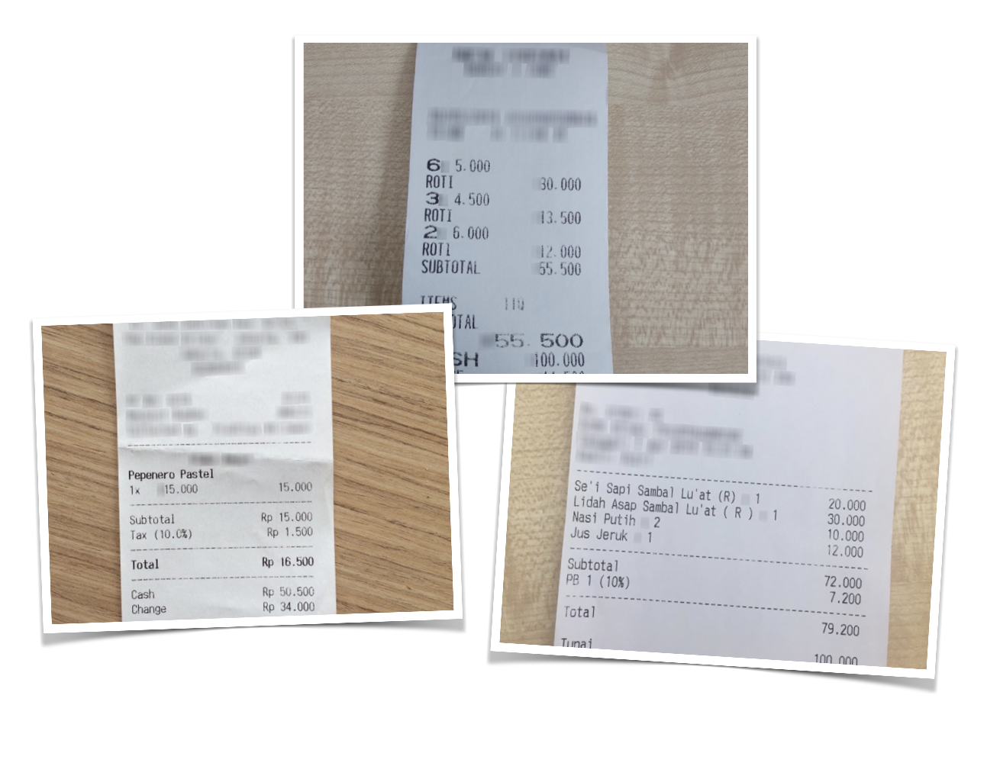

🔎 **`finvisualclf_tickets`** is a ViT (Visual Transformer) model, which can be used to carry out Binary Classification (true or false) on pictures / photos / images. 

🔎 Classes detected by the model:

* **ticket**
* **no_ticket** 

## Download Sample images

In [ ]:
!wget -q https://raw.githubusercontent.com/JohnSnowLabs/spark-nlp-workshop/master/tutorials/streamlit_notebooks/finance/data/receipt_image_examples/image01.png
!wget -q https://raw.githubusercontent.com/JohnSnowLabs/spark-nlp-workshop/master/tutorials/streamlit_notebooks/finance/data/receipt_image_examples/image02.png
!wget -q https://raw.githubusercontent.com/JohnSnowLabs/spark-nlp-workshop/master/tutorials/streamlit_notebooks/finance/data/receipt_image_examples/image03.png
!wget -q https://raw.githubusercontent.com/JohnSnowLabs/spark-nlp-workshop/master/tutorials/streamlit_notebooks/finance/data/receipt_image_examples/image04.png
!wget -q https://raw.githubusercontent.com/JohnSnowLabs/spark-nlp-workshop/master/tutorials/streamlit_notebooks/finance/data/receipt_image_examples/image05.png
!wget -q https://raw.githubusercontent.com/JohnSnowLabs/spark-nlp-workshop/master/tutorials/streamlit_notebooks/finance/data/receipt_image_examples/image06.png

## Load test images

In [ ]:
test_image = spark.read\
    .format("image")\
    .option("dropInvalid", value = True)\
    .load("*image0*.png").toDF("image")

In [ ]:
test_image.select("image.origin", "image.width", "image.height").show(truncate=False)

+---------------------------------------------------------------------------+-----+------+
|origin                                                                     |width|height|
+---------------------------------------------------------------------------+-----+------+
|file:///home/jovyan/work/shared/gokhan/FIN_LEGAL/6-Vis.Doc.Clf./image05.png|960  |1280  |
|file:///home/jovyan/work/shared/gokhan/FIN_LEGAL/6-Vis.Doc.Clf./image01.png|1108 |1478  |
|file:///home/jovyan/work/shared/gokhan/FIN_LEGAL/6-Vis.Doc.Clf./image02.png|1920 |2889  |
|file:///home/jovyan/work/shared/gokhan/FIN_LEGAL/6-Vis.Doc.Clf./image06.png|1556 |1760  |
|file:///home/jovyan/work/shared/gokhan/FIN_LEGAL/6-Vis.Doc.Clf./image04.png|1275 |1650  |
|file:///home/jovyan/work/shared/gokhan/FIN_LEGAL/6-Vis.Doc.Clf./image03.png|1108 |1478  |
+---------------------------------------------------------------------------+-----+------+



In [ ]:
document_assembler = ImageAssembler() \
    .setInputCol("image") \
    .setOutputCol("image_assembler")

imageClassifier_loaded = ViTForImageClassification.pretrained("finvisualclf_tickets", "en", "finance/models")\
  .setInputCols(["image_assembler"])\
  .setOutputCol("classes")

pipeline = Pipeline().setStages([
    document_assembler,
    imageClassifier_loaded
])

2022-09-19 09:56:16.237383: I external/org_tensorflow/tensorflow/core/platform/cpu_feature_guard.cc:151] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [ ]:
result = pipeline.fit(test_image).transform(test_image).cache()

In [ ]:
result.show()

+--------------------+--------------------+--------------------+
|               image|     image_assembler|             classes|
+--------------------+--------------------+--------------------+
|{file:///home/jov...|[{image, file:///...|[{category, 0, 5,...|
|{file:///home/jov...|[{image, file:///...|[{category, 0, 5,...|
|{file:///home/jov...|[{image, file:///...|[{category, 0, 8,...|
|{file:///home/jov...|[{image, file:///...|[{category, 0, 8,...|
|{file:///home/jov...|[{image, file:///...|[{category, 0, 8,...|
|{file:///home/jov...|[{image, file:///...|[{category, 0, 5,...|
+--------------------+--------------------+--------------------+



In [ ]:
result_df = result.select(F.explode(F.arrays_zip(result.classes.result, 
                                                 result.classes.metadata)).alias("cols"))\
                  .select(F.expr("cols['1']['origin']").alias("images"),
                          F.expr("cols['0']").alias("class"),
                          F.expr("cols['1']['Some(ticket)']").alias("ticket_confidence"),
                          F.expr("cols['1']['Some(no_ticket)']").alias("no_ticket_confidence"))
                          

result_df.show(truncate=False)

+---------------------------------------------------------------------------+---------+-----------------+--------------------+
|images                                                                     |class    |ticket_confidence|no_ticket_confidence|
+---------------------------------------------------------------------------+---------+-----------------+--------------------+
|file:///home/jovyan/work/shared/gokhan/FIN_LEGAL/6-Vis.Doc.Clf./image05.png|ticket   |0.99478793       |0.0052120956        |
|file:///home/jovyan/work/shared/gokhan/FIN_LEGAL/6-Vis.Doc.Clf./image01.png|ticket   |0.9956969        |0.004303068         |
|file:///home/jovyan/work/shared/gokhan/FIN_LEGAL/6-Vis.Doc.Clf./image02.png|no_ticket|8.1447803E-4     |0.9991855           |
|file:///home/jovyan/work/shared/gokhan/FIN_LEGAL/6-Vis.Doc.Clf./image06.png|no_ticket|8.130495E-4      |0.99918693          |
|file:///home/jovyan/work/shared/gokhan/FIN_LEGAL/6-Vis.Doc.Clf./image04.png|no_ticket|8.1387075E-4     |0.9991